In [ ]:
!nvidia-smi

Tue Dec 26 11:42:12 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   39C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

#Tải YoLoV5 từ gitHub để tiến hành Train

In [ ]:
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

Cloning into 'yolov5'...
remote: Enumerating objects: 16114, done.
remote: Counting objects: 100% (25/25), done.
remote: Compressing objects: 100% (24/24), done.
remote: Total 16114 (delta 8), reused 10 (delta 1), pack-reused 16089
Receiving objects: 100% (16114/16114), 14.85 MiB | 25.91 MiB/s, done.
Resolving deltas: 100% (11031/11031), done.
/content/yolov5
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 190.6/190.6 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 663.2/663.2 kB 16.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 5.7 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
imageio 2.31.6 requires pillow<10.1.0,>=8.3.2, but you have pillow 10.1.0 which is incompatible.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
  import torch
  from IPython.display import Image, clear_output  # to display images
  print('torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

torch 2.1.0+cu121 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15102MB, multi_processor_count=40)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
import shutil

Mounted at /content/drive


In [ ]:
# from roboflow import Roboflow
# rf = Roboflow(model_format="yolov5", notebook="ultralytics")

#Tải bộ data của nhóm từ Roboflow với việc train là Yolo V5

In [ ]:
%cd /content/yolov5
  #after following the link above, recieve python code with these fields filled in

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="2qfrIwZkt6G31Ap3K7Fh")
project = rf.workspace("uit-5rhkt").project("lisence-car")
dataset = project.version(17).download("yolov5")




/content/yolov5
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Lisence-Car-17 in yolov5pytorch:: 100%|██████████| 7658/7658 [00:02<00:00, 2590.09it/s]


#Bắt đầu Train với train.py

In [ ]:
!python train.py --img 640 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --weights yolov5m.pt --cache

2023-12-26 11:45:50.555875: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-26 11:45:50.555940: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-26 11:45:50.557843: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
train: weights=yolov5m.pt, cfg=, data=/content/yolov5/Lisence-Car-17/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=

In [ ]:
import shutil

folder_path_colab = "/content/yolov5/runs"
folder_path_drive = "/content/drive/MyDrive/yolov5final/"

shutil.copytree(folder_path_colab, folder_path_drive)

'/content/drive/MyDrive/yolov5final/'

In [ ]:
!python val.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --data /content/yolov5/Lisence-Car-16/data.yaml --task val --iou-thres 0.5

Traceback (most recent call last):
  File "/content/yolov5/val.py", line 410, in <module>
    opt = parse_opt()
  File "/content/yolov5/val.py", line 367, in parse_opt
    opt.data = check_yaml(opt.data)  # check YAML
  File "/content/yolov5/utils/general.py", line 442, in check_yaml
    return check_file(file, suffix)
  File "/content/yolov5/utils/general.py", line 468, in check_file
    assert len(files), f'File not found: {file}'  # assert file was found
AssertionError: File not found: /content/yolov5/Lisence-Car-16/data.yaml


In [ ]:
!python val.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --data /content/yolov5/Lisence-Car-16/data.yaml --task test --iou-thres 0.5

In [ ]:
!python val.py --weights /content/yolov5/runs/train/exp2/weights/best.pt --data /content/yolov5/Lisence-Car-16/data.yaml --task test --iou-thres 0.75

In [ ]:
!python val.py --weights /content/yolov5/runs/train/exp/weights/best.pt --data /content/yolov5/Lisence-Car-16/data.yaml --task test --iou-thres 0.9

val: data=/content/yolov5/Lisence-Car-16/data.yaml, weights=['/content/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.9, max_det=300, task=test, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-253-g63555c8 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Traceback (most recent call last):
  File "/content/yolov5/val.py", line 411, in <module>
    main(opt)
  File "/content/yolov5/val.py", line 382, in main
    run(**vars(opt))
  File "/usr/local/lib/python3.10/dist-packages/torch/utils/_contextlib.py", line 115, in decorate_context
    return func(*args, **kwargs)
  File "/content/yolov5/val.py", line 143, in run
    model = DetectMultiBackend(weights, device=device, dnn=dnn, data=data, fp16=half)
  File "/content/yolov5/models/common.py", line 356, in __ini

In [ ]:
shutil.copytree("/content/yolov5/runs/val/", "/content/drive/MyDrive/datav3/IOU")

FileExistsError: ignored

#Kết quả từ việc train

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/F1_curve.png', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/PR_curve.png', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/R_curve.png', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/P_curve.png', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/confusion_matrix.png', width=1000)

In [ ]:
%cd {HOME}
Image(filename=f'/content/yolov5/runs/train/exp/results.png', width=1000)

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/train_batch0.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/train_batch1.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/train_batch2.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/val_batch0_labels.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/val_batch1_labels.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/val_batch2_labels.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/val_batch0_pred.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/val_batch1_pred.jpg', width=1000)

In [ ]:
Image(filename=f'/content/yolov5/runs/train/exp/val_batch2_pred.jpg', width=1000)

In [ ]:
import pandas as pd
pd.read_csv('/content/yolov5/runs/train/exp/results.csv')

In [ ]:
project.version(dataset.version).deploy(model_type="yolov5", model_path=f"/content/yolov5/runs/train/exp")

#Tiến hành detect tập test
Sau khi có được trong số thích hợp best.pt tiến hành detect với tập test

In [ ]:
!python detect.py --weights /content/drive/MyDrive/yolov5m3/train/exp2/weights/best.pt --img 640 --conf 0.9 --source {dataset.location}/train/images --save-crop

detect: weights=['/content/drive/MyDrive/yolov5m3/train/exp2/weights/best.pt'], source=/content/yolov5/Lisence-Car-16/train/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.9, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_csv=False, save_conf=False, save_crop=True, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-253-g63555c8 Python-3.10.12 torch-2.1.0+cu121 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
Model summary: 212 layers, 20865057 parameters, 0 gradients, 47.9 GFLOPs
WARNING ⚠️ NMS time limit 0.550s exceeded
image 1/2514 /content/yolov5/Lisence-Car-16/train/images/00000001_jpg.rf.b3f5bf0071845acebf6478ccd064c6eb.jpg: 640x640 1 Bien_trang, 26.9ms
image 2/2514 /content/yolov5/Lisence-Car-16/train/images/00000003_jpg.rf.e627e0d459666468b6ca3347

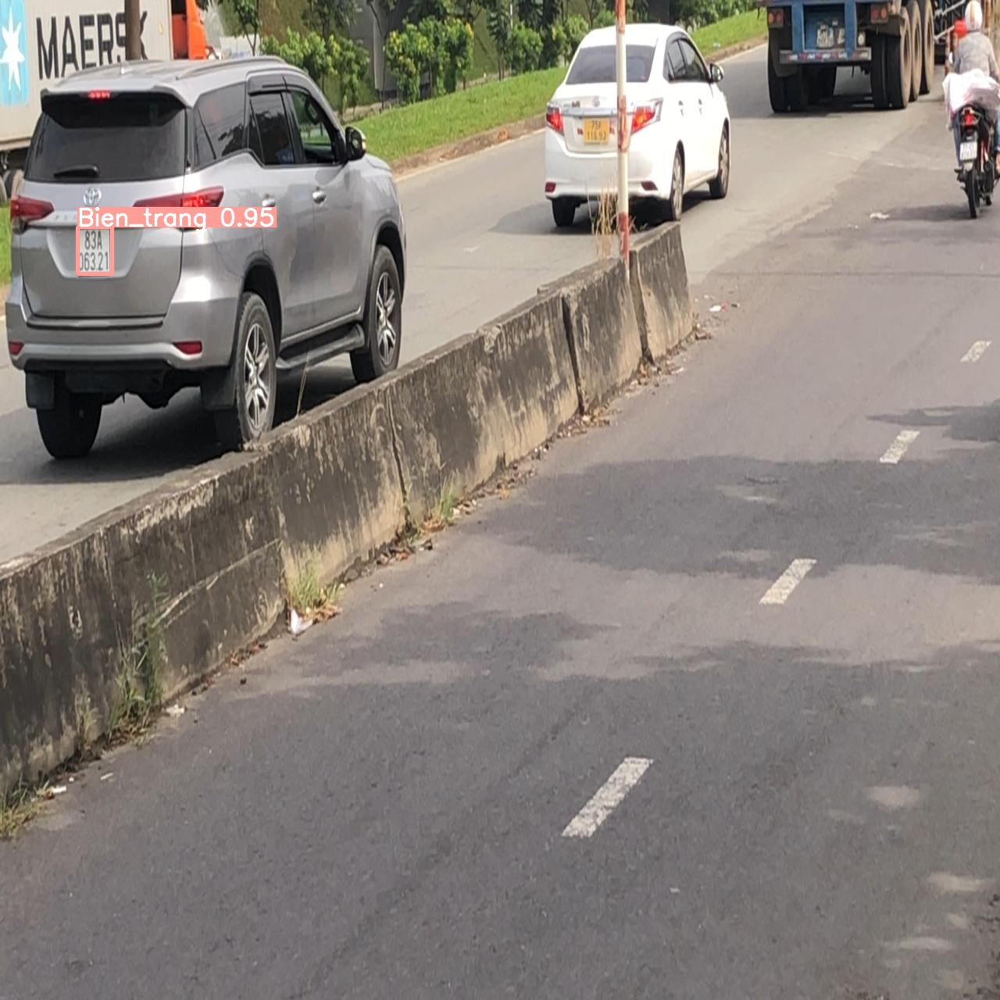

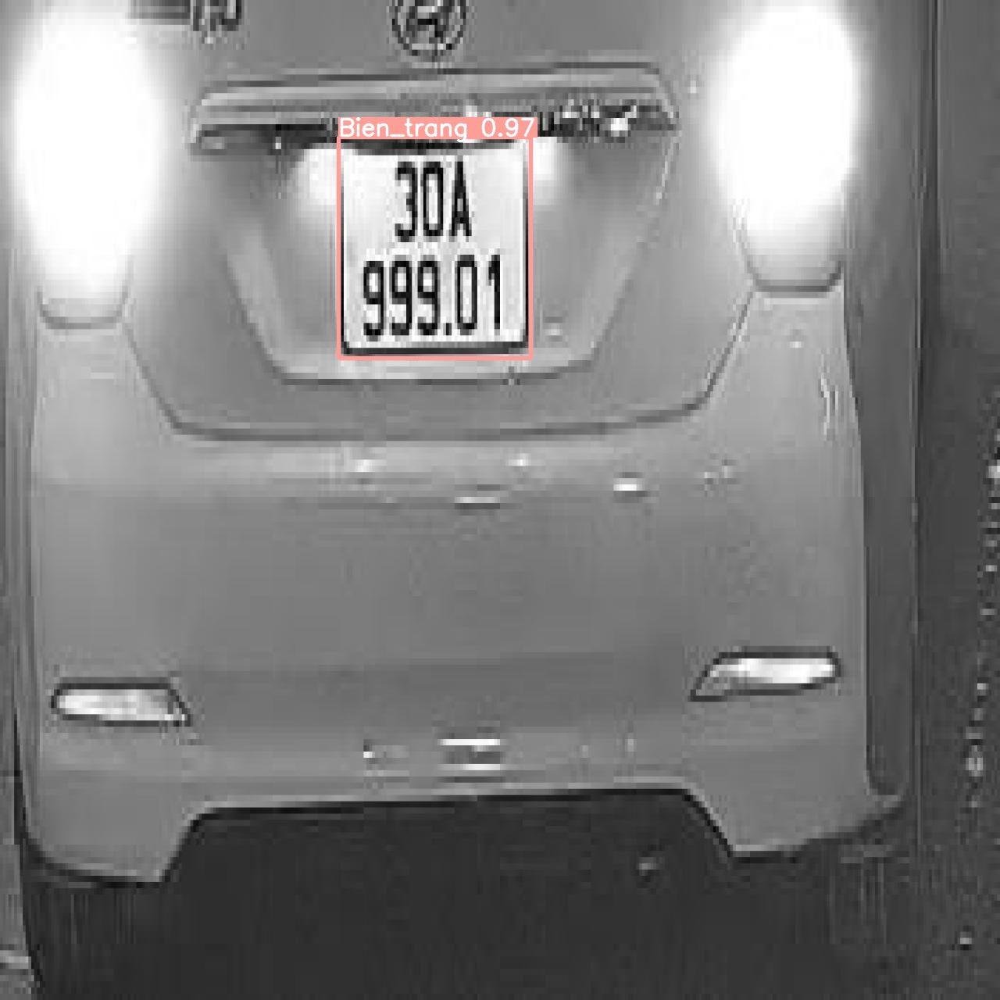

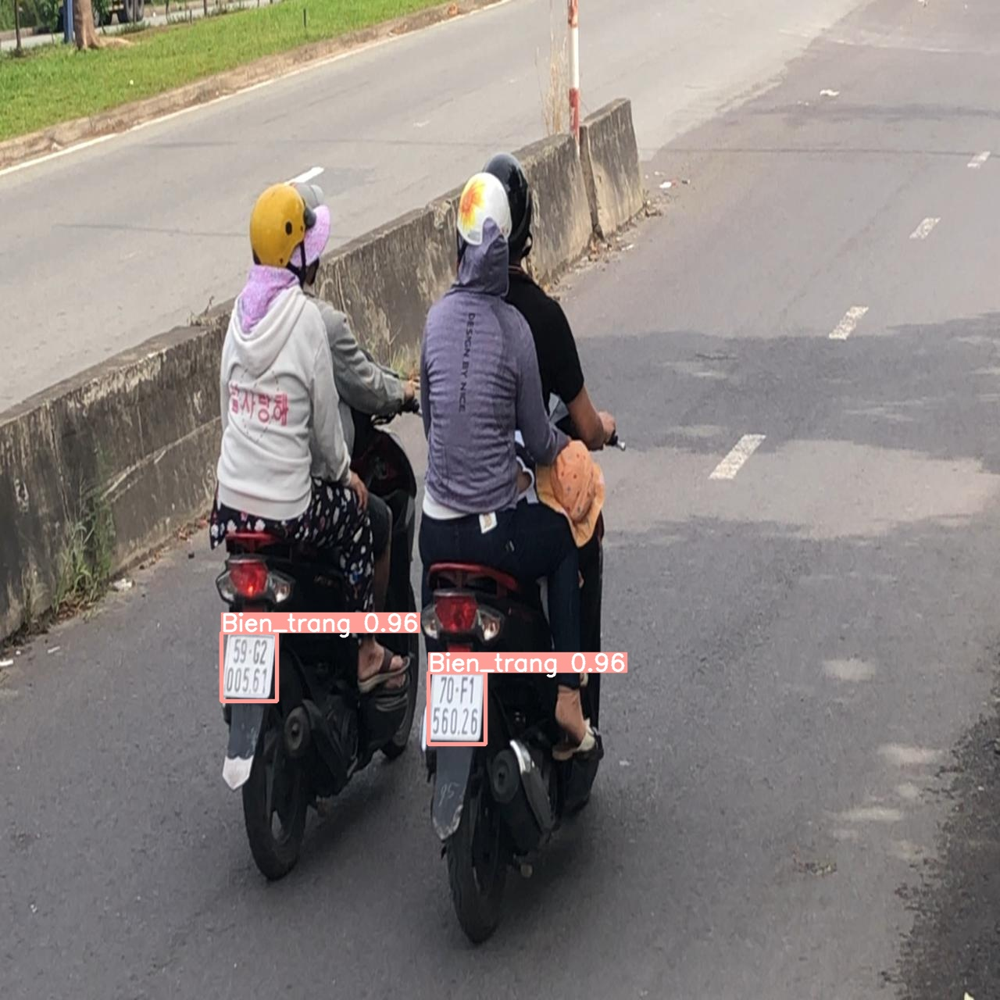

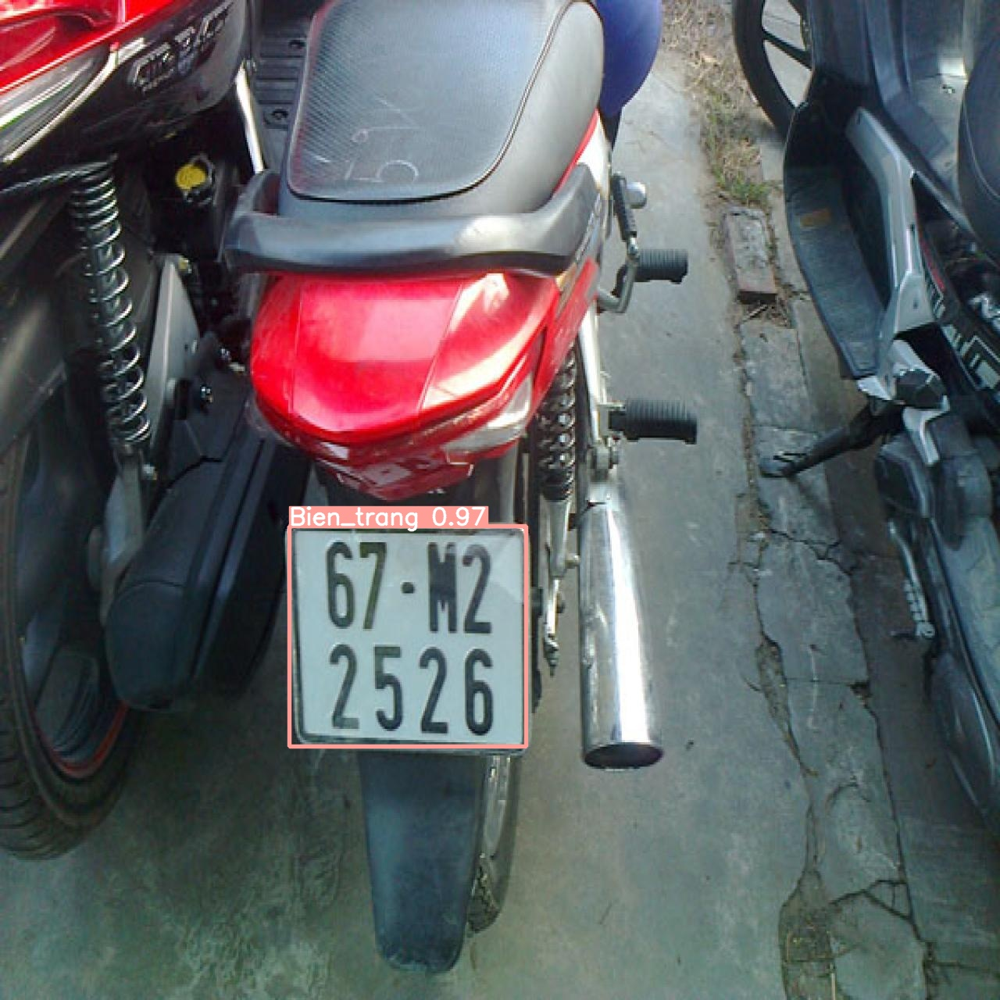

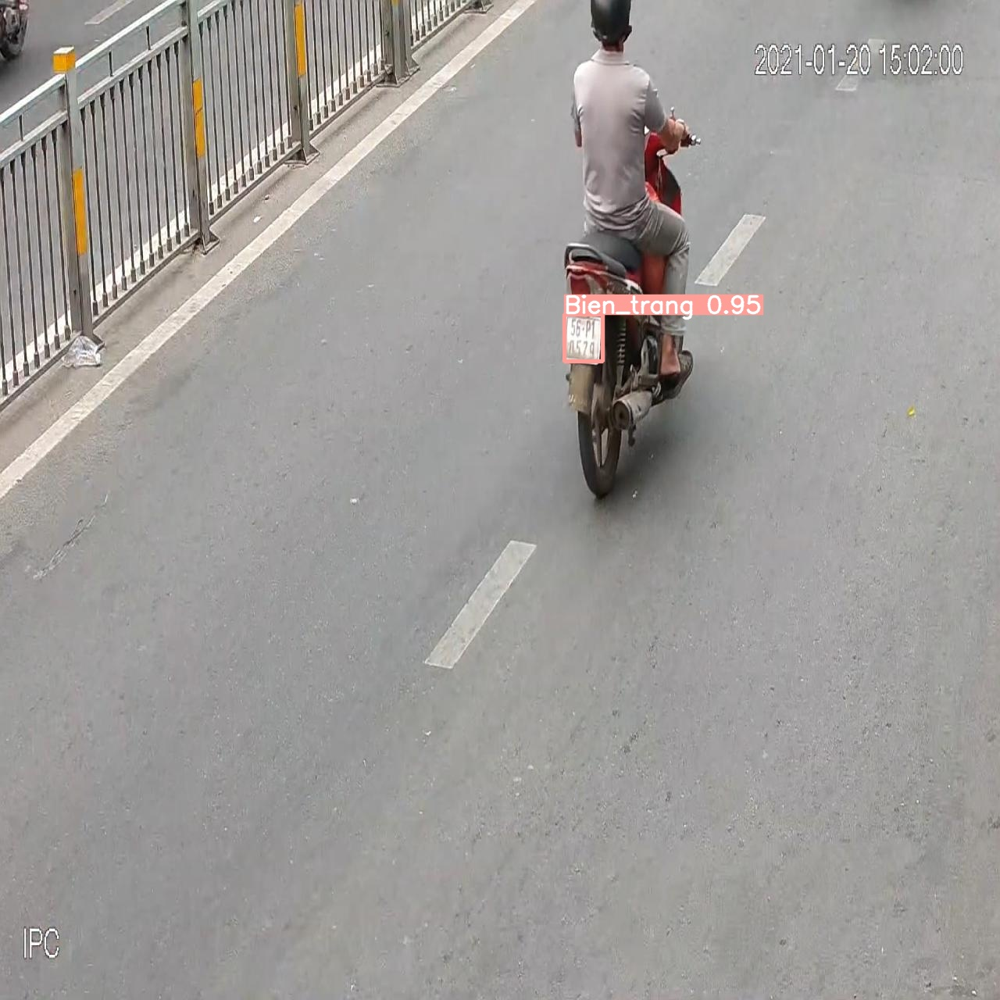

...

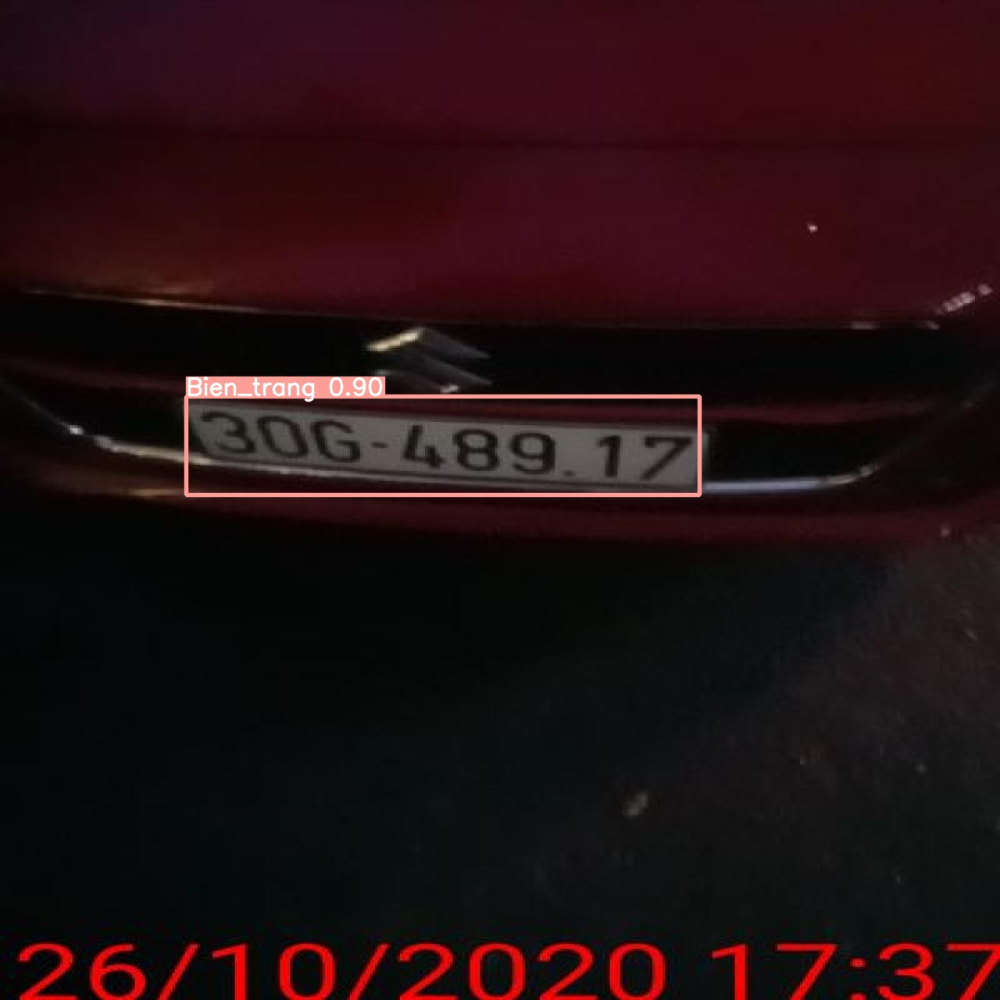

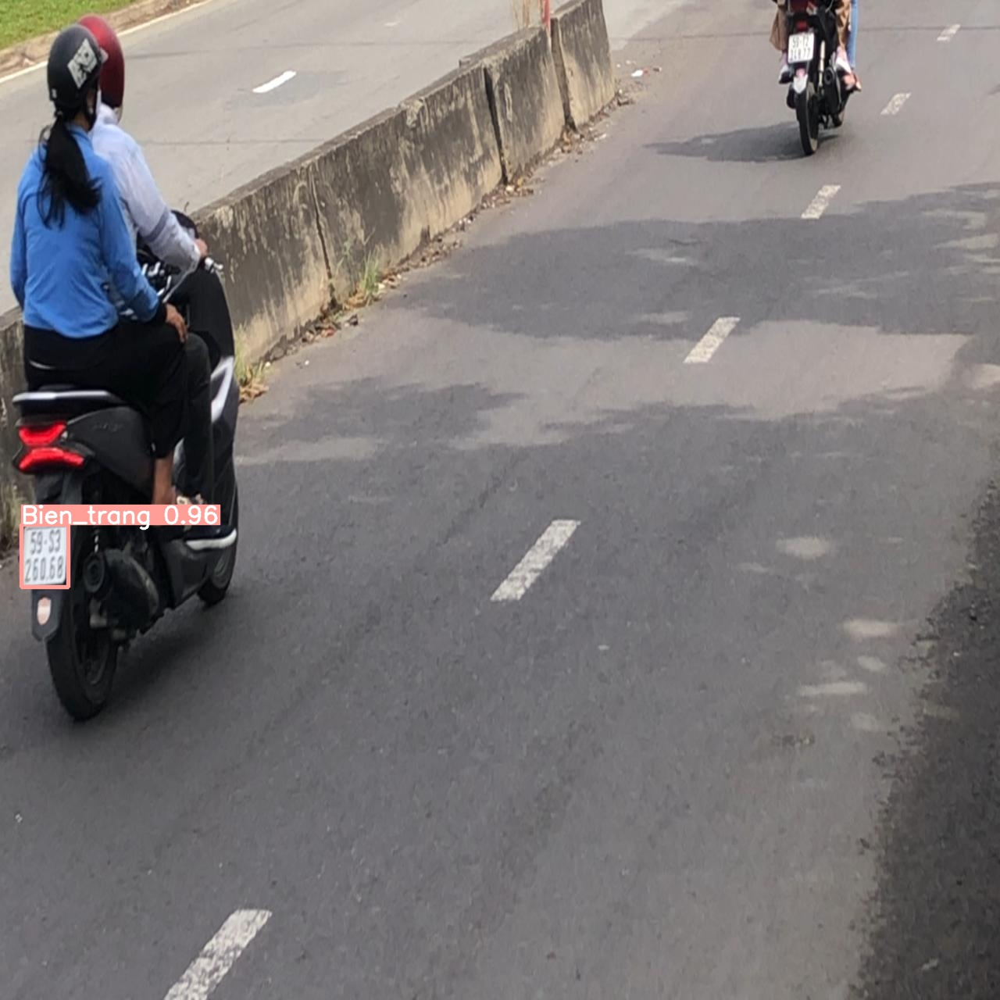

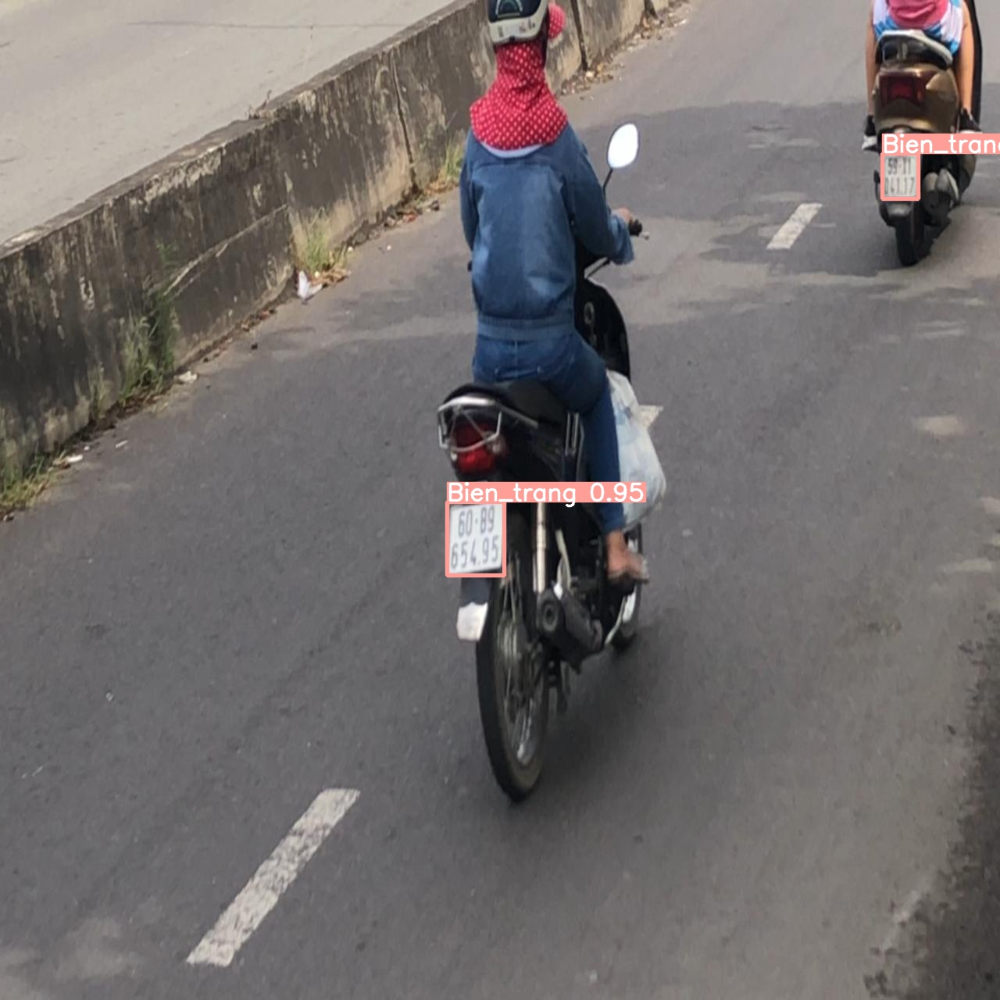

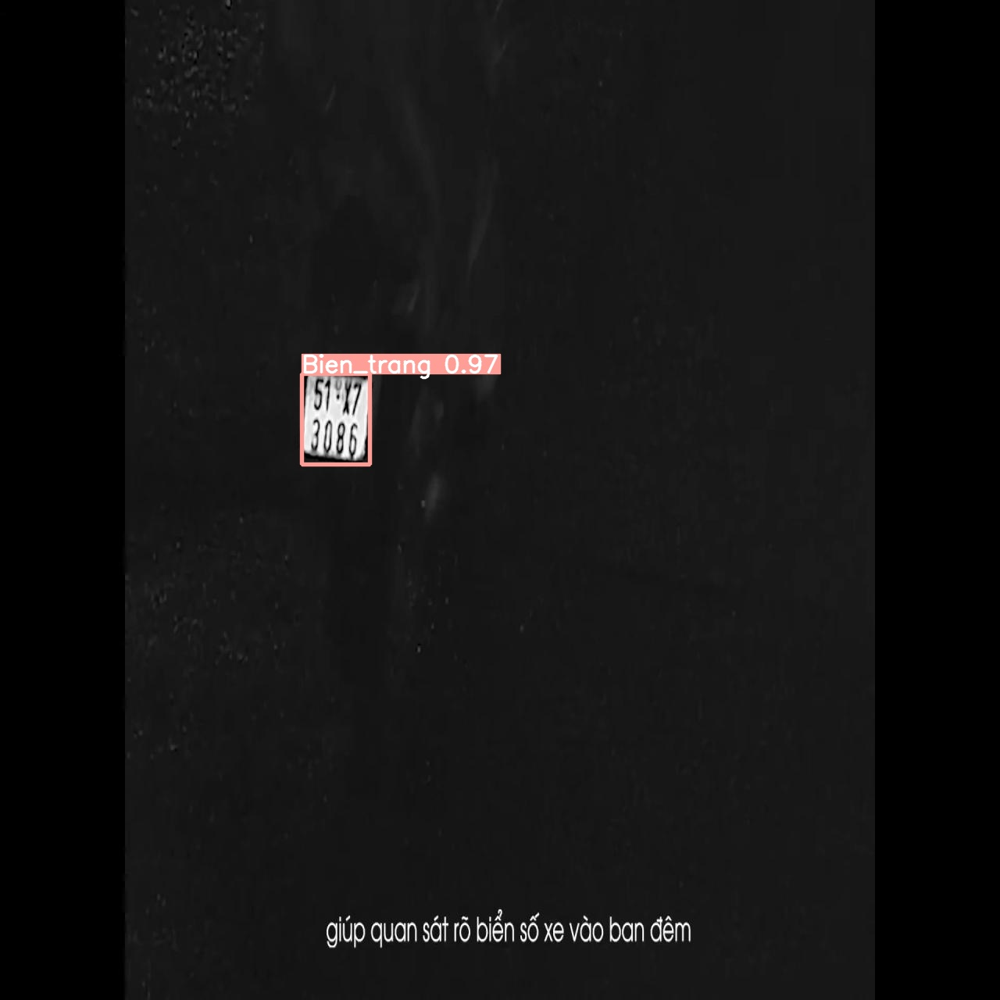

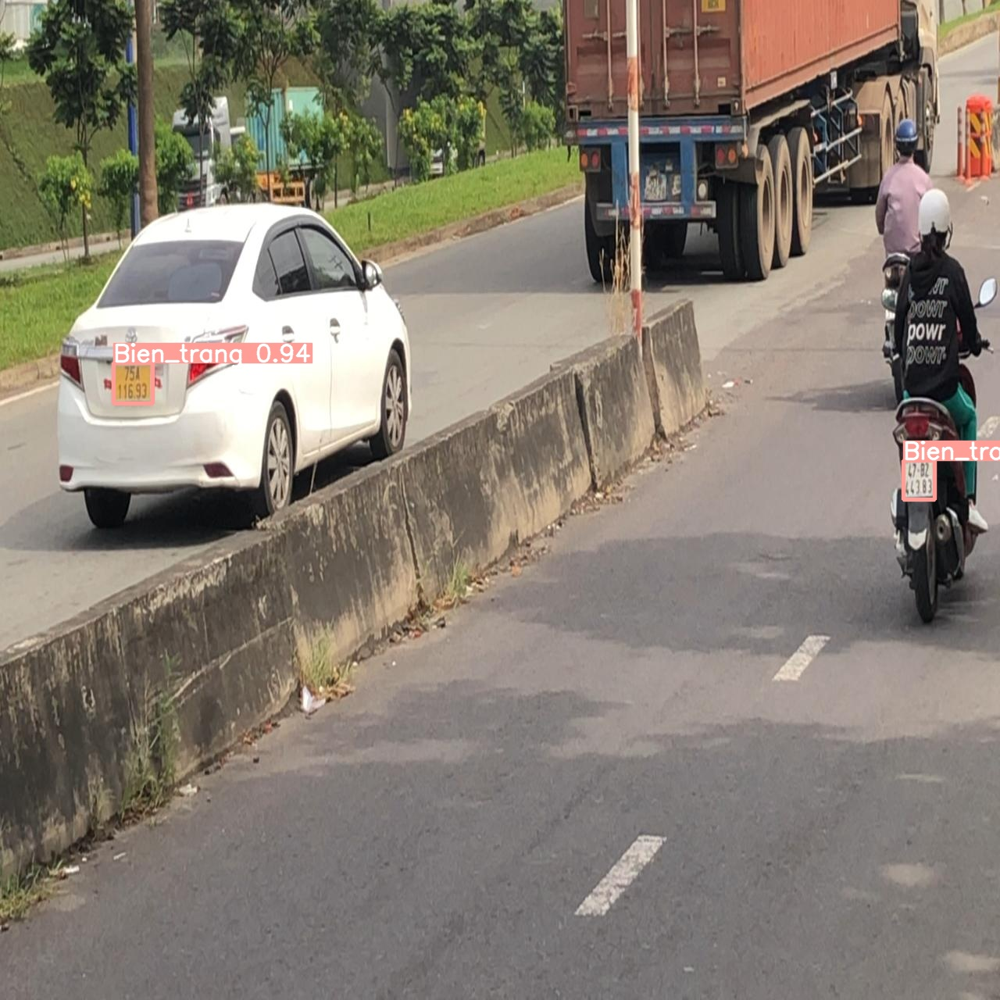

In [ ]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

Lưu file best.pt để có thể detect sau này  

In [ ]:
#export your model's weights for future use
from google.colab import files
files.download('/content/yolov5/runs/detect')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
shutil.copytree("/content/yolov5/runs/detect/exp/crops", "/content/drive/MyDrive/datav3/test")

'/content/drive/MyDrive/datav3/test'

In [ ]:
shutil.copytree("/content/yolov5/runs/detect/exp3/crops/Bien_vang", "/content/drive/MyDrive/datav3/train")

'/content/drive/MyDrive/datav3/train'